# Final Project for IANNwTF 2022/23 


Learning to colorize grayscale dog pictures with the Stanford Dog Dataset.  

In [45]:
import numpy as np
import tensorflow as tf
import tensorflow_io as tfio
import tensorboard
from PIL import Image
import os
from datetime import datetime
from skimage.io import imread, imshow
import matplotlib.pyplot as plt
import random
from tqdm import tqdm
import pickle
from models import Only_Classification_Model, Only_Colorization_Model, Model
from training_loops import training_loop, training_loop_classification, training_loop_colorization
from visualization import visualize

In [50]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
  try:
    # Currently, memory growth needs to be the same across GPUs
    for gpu in gpus:
      tf.config.experimental.set_memory_growth(gpu, True)
    logical_gpus = tf.config.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
  except RuntimeError as e:
    # Memory growth must be set before GPUs have been initialized
    print(e)


1 Physical GPUs, 1 Logical GPUs


In [3]:
# get data
train_ds,  test_ds = tf.keras.utils.image_dataset_from_directory(directory="data/Images", label_mode="categorical", batch_size=None, shuffle=False, image_size=(256,256), validation_split=0.1, subset="both", crop_to_aspect_ratio=True)
print(train_ds.class_names)

class_names = train_ds.class_names
normalizing_layer = tf.keras.layers.Rescaling(1./255)
flip_layer = tf.keras.layers.RandomFlip()
rotation_layer = tf.keras.layers.RandomRotation((-0.1,0.1))


def preprocess_train(data):

    data = data.map(lambda x,y: (normalizing_layer(x), y))
    data = data.map(lambda x,y: (flip_layer(x), y))
    data = data.map(lambda x,y: (rotation_layer(x), y))
    data = data.map(lambda x,y: (tfio.experimental.color.rgb_to_lab(x), tf.cast(y, tf.int32)))
    data = data.map(lambda image, label: (((tf.expand_dims((image[:,:,0]/200 + 0.5), -1), ((image[:,:,1:]/200) + 0.5))), label))

    data = data.shuffle(1000).batch(64).prefetch(tf.data.AUTOTUNE)

    return data

def preprocess_test(data):
    data = data.map(lambda x,y: (normalizing_layer(x), y))
    data = data.map(lambda x,y: (tfio.experimental.color.rgb_to_lab(x), tf.cast(y, tf.int32)))

    data = data.map(lambda image, label: (((tf.expand_dims((image[:,:,0]/200 + 0.5), -1), ((image[:,:,1:]/200) + 0.5))), label))

    data = data.shuffle(1000).batch(64).prefetch(tf.data.AUTOTUNE)

    return data

train_data = preprocess_train(train_ds)
test_data = preprocess_test(test_ds)

Found 20580 files belonging to 120 classes.
Using 18522 files for training.
Using 2058 files for validation.
['n02085620-Chihuahua', 'n02085782-Japanese_spaniel', 'n02085936-Maltese_dog', 'n02086079-Pekinese', 'n02086240-Shih-Tzu', 'n02086646-Blenheim_spaniel', 'n02086910-papillon', 'n02087046-toy_terrier', 'n02087394-Rhodesian_ridgeback', 'n02088094-Afghan_hound', 'n02088238-basset', 'n02088364-beagle', 'n02088466-bloodhound', 'n02088632-bluetick', 'n02089078-black-and-tan_coonhound', 'n02089867-Walker_hound', 'n02089973-English_foxhound', 'n02090379-redbone', 'n02090622-borzoi', 'n02090721-Irish_wolfhound', 'n02091032-Italian_greyhound', 'n02091134-whippet', 'n02091244-Ibizan_hound', 'n02091467-Norwegian_elkhound', 'n02091635-otterhound', 'n02091831-Saluki', 'n02092002-Scottish_deerhound', 'n02092339-Weimaraner', 'n02093256-Staffordshire_bullterrier', 'n02093428-American_Staffordshire_terrier', 'n02093647-Bedlington_terrier', 'n02093754-Border_terrier', 'n02093859-Kerry_blue_terrier'

2023-03-27 23:07:50.963887: I tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:630] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


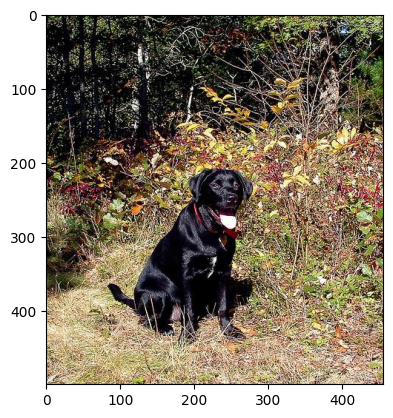

In [6]:
sample_image = imread("data/Images/n02099712-Labrador_retriever/n02099712_1200.jpg")/255
sample_image = tf.convert_to_tensor(sample_image, dtype=tf.float32)
plt.imshow(sample_image)
sample_image = tfio.experimental.color.rgb_to_lab(sample_image)


In [ ]:
epochs = 100
optimizer1 = tf.keras.optimizers.Adam()
optimizer2 = tf.keras.optimizers.Adam()
loss_function_color = tf.keras.losses.MeanSquaredError()
loss_function_category = tf.keras.losses.CategoricalCrossentropy()

no_of_classes = 120
combined_model= Model(no_of_classes=no_of_classes, optimizer1=optimizer1, optimizer2=optimizer2, loss_function_color=loss_function_color, loss_function_category=loss_function_category)

current_time = datetime.now().strftime("%Y%m%d-%H%M%S")
save_path = f"models/{current_time}"
train_log_path = f"logs/{current_time}/model_BN_DO_GA_Adam/train"
test_log_path = f"logs/{current_time}/model_BN_DO_GA_Adam/test"
train_summary_writer = tf.summary.create_file_writer(train_log_path)
test_summary_writer = tf.summary.create_file_writer(test_log_path)

training_loop(combined_model, train_data, test_data, epochs, train_summary_writer, test_summary_writer, save_path)


  9%|▉         | 3/33 [00:00<00:07,  3.76it/s]

n02107683-Bernese_mountain_dog n02112706-Brabancon_griffon
n02107683-Bernese_mountain_dog n02113023-Pembroke


 12%|█▏        | 4/33 [00:01<00:05,  4.86it/s]

n02107683-Bernese_mountain_dog n02112018-Pomeranian


 21%|██        | 7/33 [00:01<00:04,  6.27it/s]

n02107683-Bernese_mountain_dog n02113799-standard_poodle


 24%|██▍       | 8/33 [00:01<00:03,  6.70it/s]

n02107683-Bernese_mountain_dog n02113023-Pembroke
n02107683-Bernese_mountain_dog n02113978-Mexican_hairless


 45%|████▌     | 15/33 [00:02<00:01, 11.07it/s]

n02107683-Bernese_mountain_dog n02113186-Cardigan


 64%|██████▎   | 21/33 [00:02<00:01,  9.72it/s]

n02107683-Bernese_mountain_dog n02115641-dingo
n02107683-Bernese_mountain_dog n02113799-standard_poodle


 76%|███████▌  | 25/33 [00:03<00:00, 11.36it/s]

n02107683-Bernese_mountain_dog n02116738-African_hunting_dog
n02107683-Bernese_mountain_dog n02116738-African_hunting_dog


 82%|████████▏ | 27/33 [00:03<00:00,  9.95it/s]

n02107683-Bernese_mountain_dog n02113712-miniature_poodle
n02107683-Bernese_mountain_dog n02112018-Pomeranian


100%|██████████| 33/33 [00:03<00:00,  8.63it/s]


n02107683-Bernese_mountain_dog n02116738-African_hunting_dog


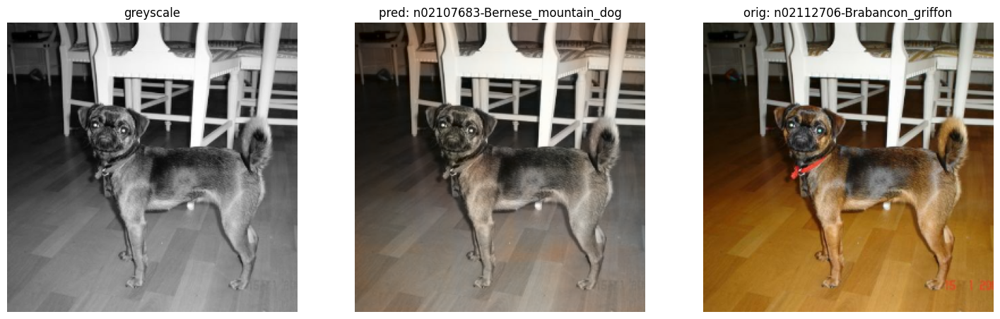

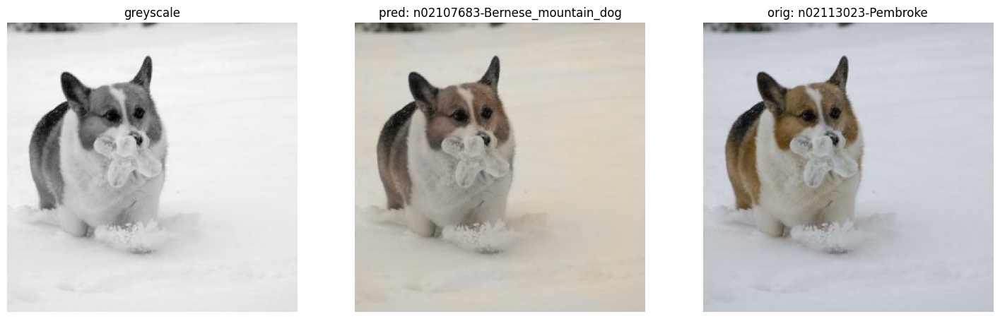

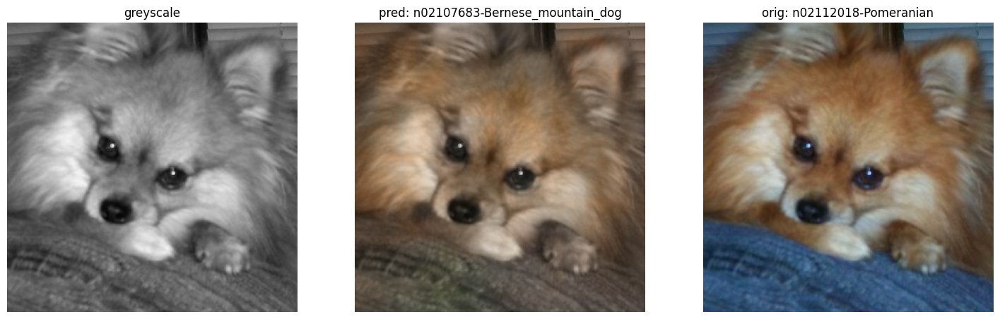

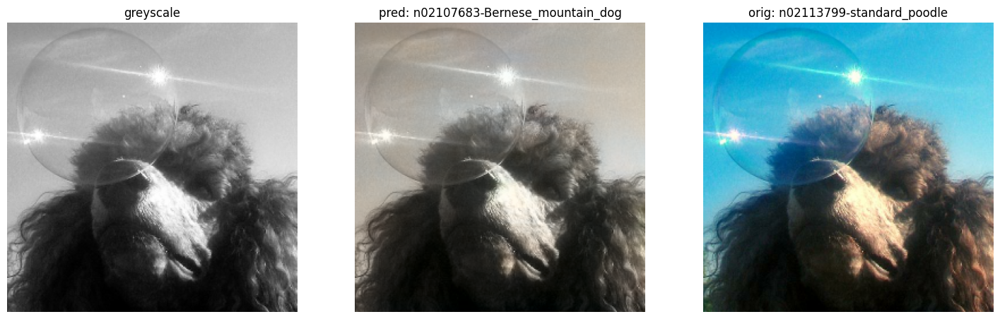

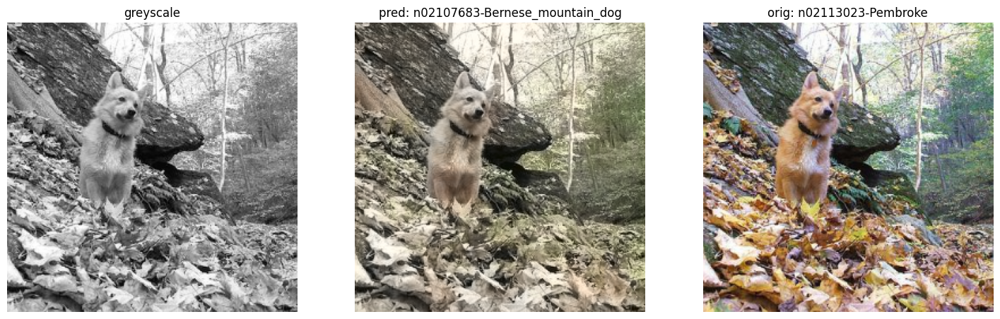

...

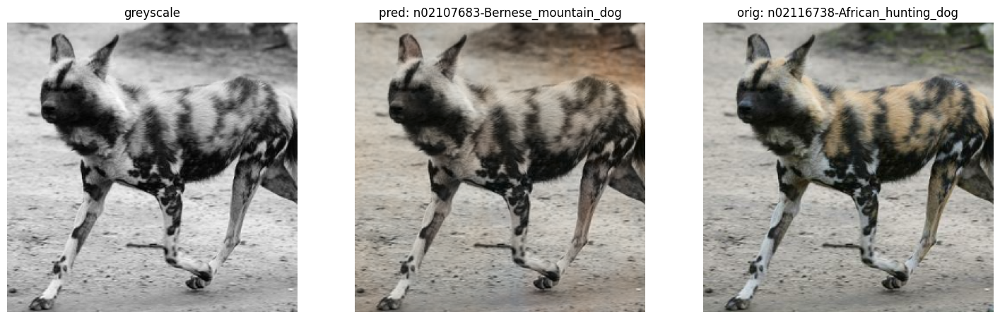

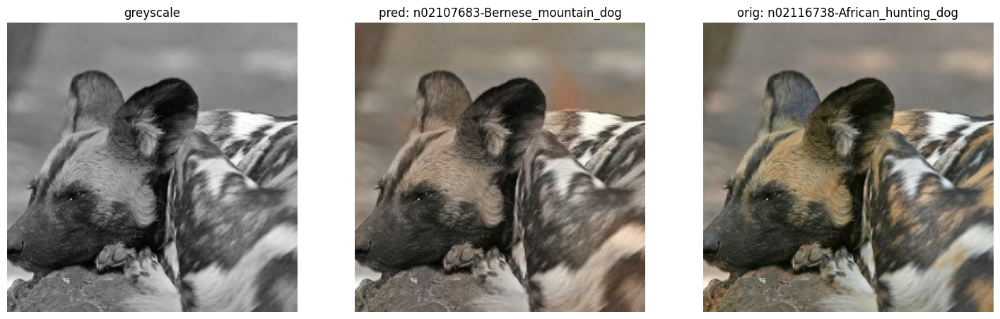

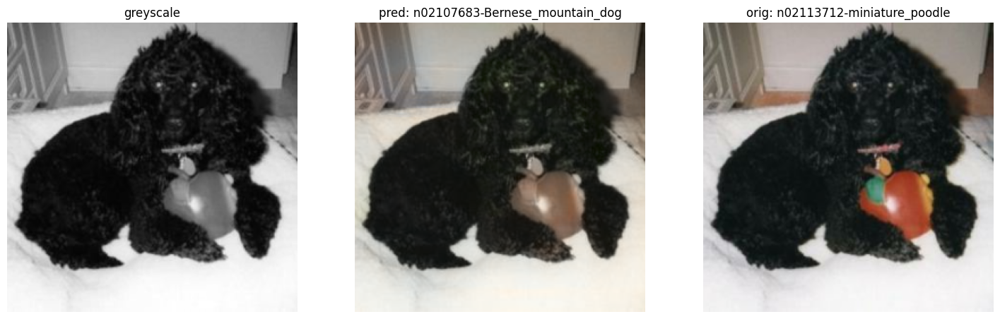

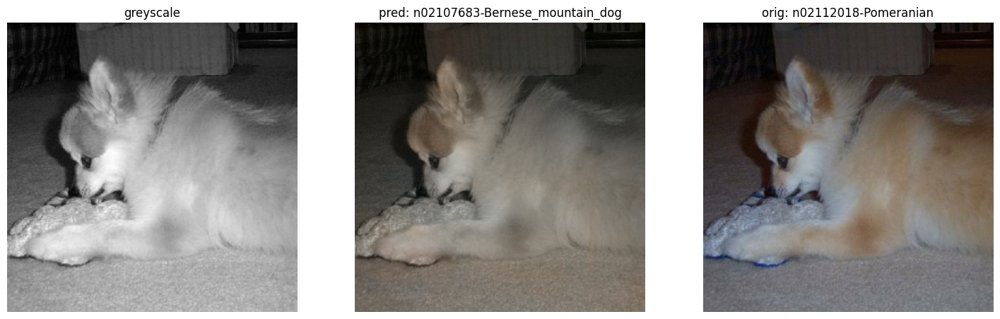

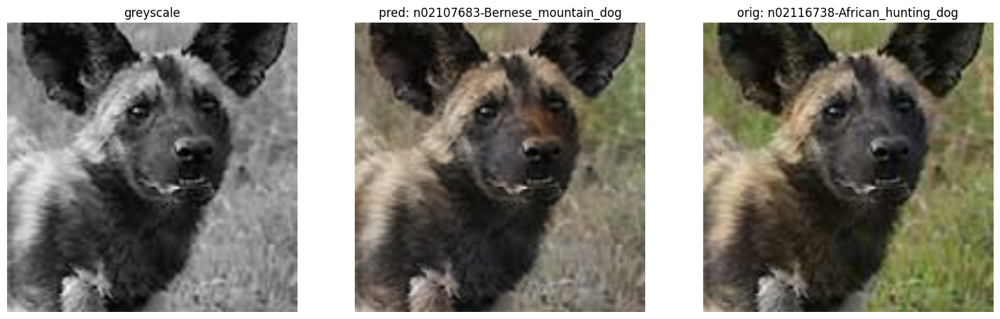

In [16]:
for data in tqdm(test_data, position=0, leave=True):
    predicted_color, predicted_label = combined_model.test_step(data)

#
    if random.random() < 0.4:
        visualize(predicted_color[0], predicted_label[0], data, class_names)


In [ ]:
epochs = 100
optimizer = tf.keras.optimizers.Adam()
loss_function_color = tf.keras.losses.MeanSquaredError()
loss_function_category = tf.keras.losses.CategoricalCrossentropy()

only_colorization = Only_Colorization_Model(optimizer=optimizer, loss_function_color=loss_function_color)

current_time = datetime.now().strftime("%Y%m%d-%H%M%S")
save_path = f"models/{current_time}"
train_log_path = f"logs/{current_time}/train"
test_log_path = f"logs/{current_time}/test"
train_summary_writer = tf.summary.create_file_writer(train_log_path)
test_summary_writer = tf.summary.create_file_writer(test_log_path)

training_loop_colorization(only_colorization, train_data, test_data, epochs, train_summary_writer, test_summary_writer, save_path)


  3%|▎         | 1/33 [00:00<00:29,  1.10it/s]

n02113186-Cardigan n02113186-Cardigan


 15%|█▌        | 5/33 [00:01<00:06,  4.42it/s]

n02112018-Pomeranian n02112018-Pomeranian


 24%|██▍       | 8/33 [00:02<00:06,  4.04it/s]

n02112350-keeshond n02112350-keeshond


 30%|███       | 10/33 [00:02<00:05,  4.52it/s]

n02112706-Brabancon_griffon n02112706-Brabancon_griffon


 33%|███▎      | 11/33 [00:02<00:05,  4.10it/s]

n02113799-standard_poodle n02113799-standard_poodle


 39%|███▉      | 13/33 [00:03<00:04,  4.50it/s]

n02113186-Cardigan n02113186-Cardigan
n02113023-Pembroke n02113023-Pembroke


 48%|████▊     | 16/33 [00:03<00:03,  4.90it/s]

n02112018-Pomeranian n02112018-Pomeranian
n02113186-Cardigan n02113186-Cardigan


 55%|█████▍    | 18/33 [00:04<00:03,  4.94it/s]

n02113799-standard_poodle n02113799-standard_poodle


 58%|█████▊    | 19/33 [00:04<00:02,  4.92it/s]

n02113799-standard_poodle n02113799-standard_poodle
n02113712-miniature_poodle n02113712-miniature_poodle


 70%|██████▉   | 23/33 [00:04<00:01,  6.66it/s]

n02113023-Pembroke n02113023-Pembroke


 79%|███████▉  | 26/33 [00:05<00:01,  4.74it/s]

n02112018-Pomeranian n02112018-Pomeranian
n02113978-Mexican_hairless n02113978-Mexican_hairless


 91%|█████████ | 30/33 [00:06<00:00,  6.62it/s]

n02112137-chow n02112137-chow


100%|██████████| 33/33 [00:06<00:00,  4.85it/s]

n02112137-chow n02112137-chow
n02113712-miniature_poodle n02113712-miniature_poodle


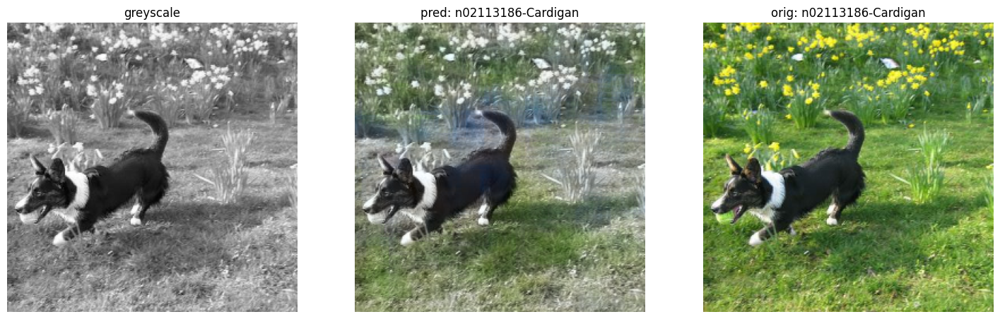

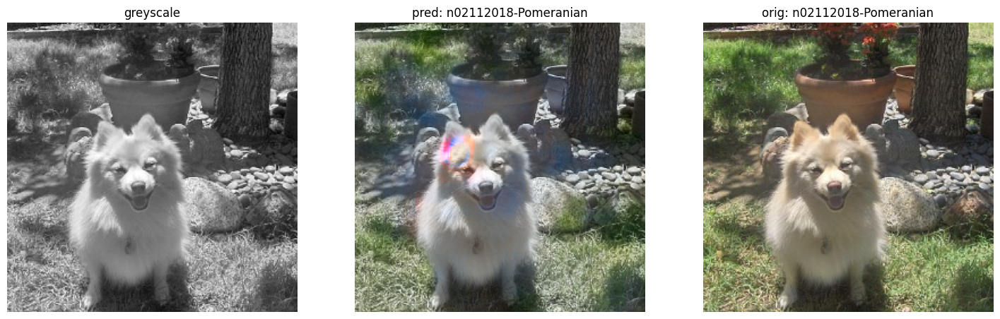

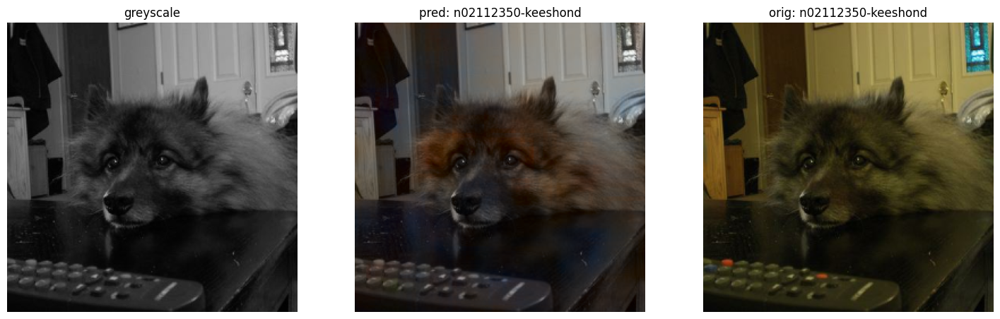

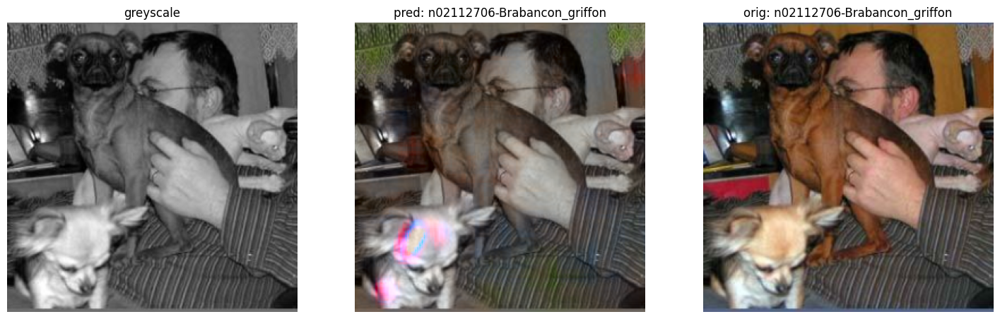

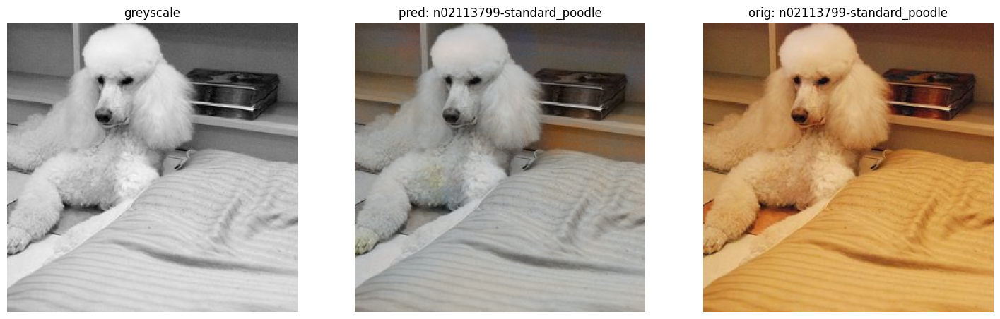

...

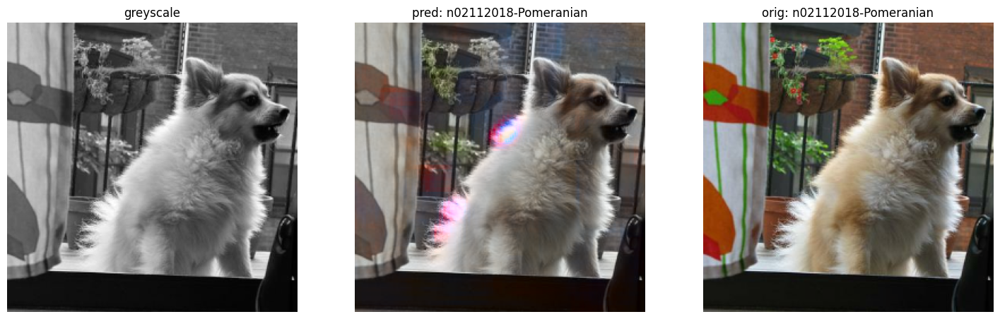

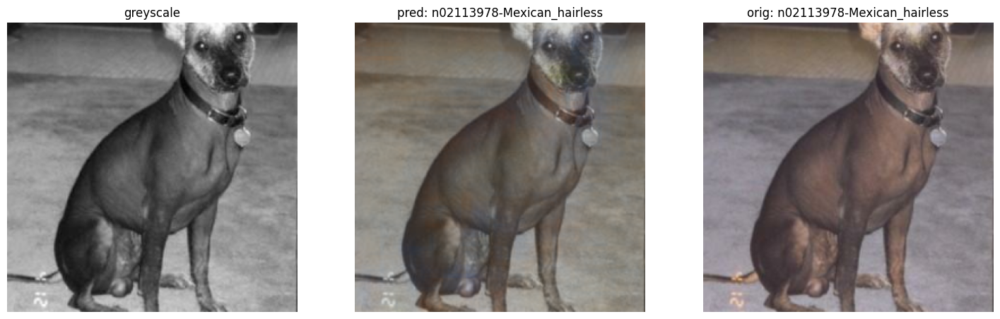

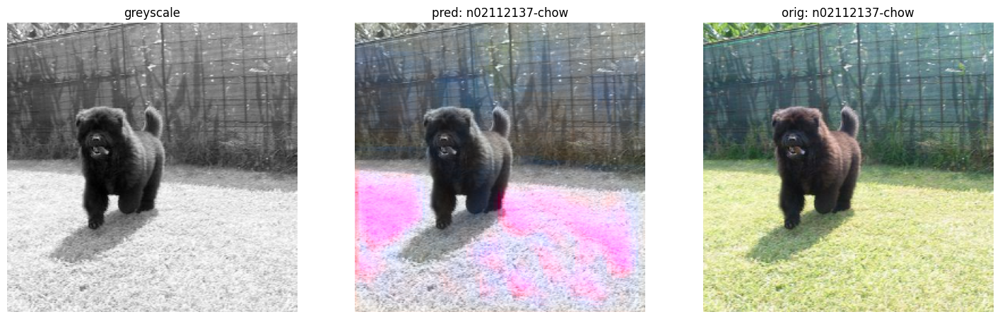

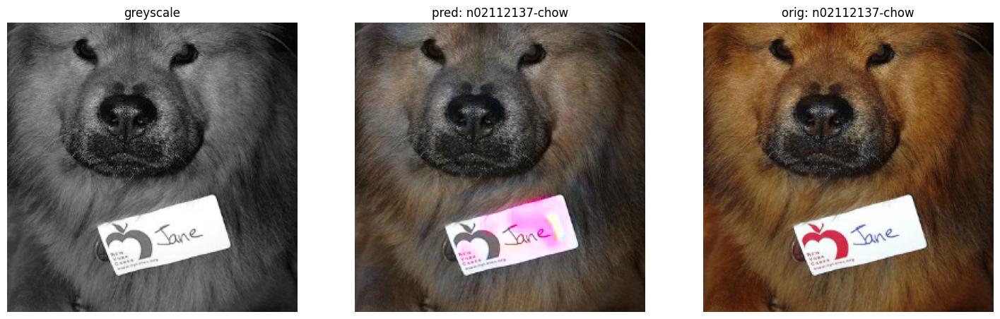

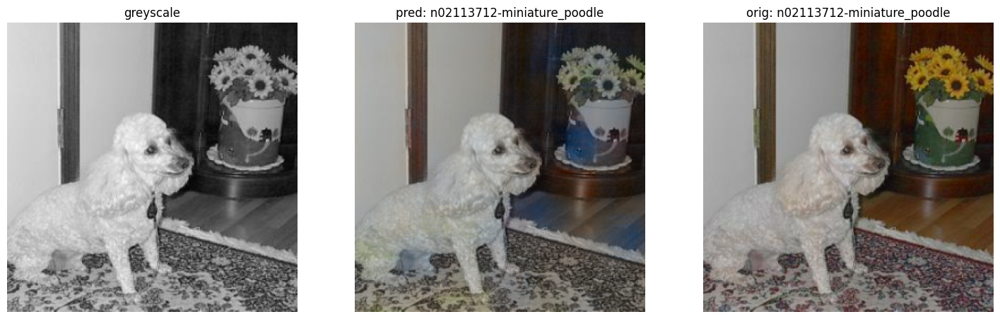

In [15]:
for data in tqdm(test_data, position=0, leave=True):
    predicted_color = only_colorization.test_step(data)

#
    if random.random() < 0.5:
        visualize(predicted_color[0], data[1][0], data, class_names)

In [ ]:
epochs = 100
optimizer = tf.keras.optimizers.Adam()
loss_function_color = tf.keras.losses.MeanSquaredError()
loss_function_category = tf.keras.losses.CategoricalCrossentropy()

no_of_classes = 120
only_classification = Only_Classification_Model(no_of_classes=no_of_classes,  optimizer=optimizer, loss_function_category=loss_function_category)

current_time = datetime.now().strftime("%Y%m%d-%H%M%S")
save_path = f"models/{current_time}"
train_log_path = f"logs/classification/MP_DO_GlobA_Adam/{current_time}/train"
test_log_path = f"logs/classification/MP_DO_GlobA_Adam/{current_time}/test"
train_summary_writer = tf.summary.create_file_writer(train_log_path)
test_summary_writer = tf.summary.create_file_writer(test_log_path)
training_loop_classification(only_classification, train_data, test_data, epochs, train_summary_writer, test_summary_writer, save_path)